In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
df = pd.read_csv('data_cleaned.csv')

In [2]:
df.columns


Index(['Job Title', 'Job Description', 'Rating', 'Company Name', 'Location',
       'Headquarters', 'Size', 'Founded', 'Type of ownership', 'Industry',
       'Sector', 'Revenue', 'Competitors', 'hourly', 'employer_provided',
       'min_salary', 'max_salary', 'avg_salary', 'job_state', 'age',
       'python_yn', 'R_yn', 'spark', 'aws', 'excel'],
      dtype='object')

In [3]:
df_model = df[['Job Title', 'Job Description', 'Rating', 'Company Name', 'Location',
       'Headquarters', 'Size', 'Founded', 'Type of ownership', 'Industry',
       'Sector', 'Revenue', 'Competitors', 'hourly', 'employer_provided',
       'min_salary', 'max_salary', 'avg_salary', 'job_state', 'age',
       'python_yn', 'R_yn', 'spark', 'aws', 'excel']]



In [4]:
df_dummy = pd.get_dummies(df_model)



In [5]:
# train test split 
from sklearn.model_selection import train_test_split
X = df_dummy.drop('avg_salary', axis =1)
y = df_dummy.avg_salary.values
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [8]:
# multiple linear regression 
import statsmodels.api as sm
X_sm = X = sm.add_constant(X)
model = sm.OLS(y,X_sm)
model

In [9]:
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.980e+28
Date:                Sun, 25 Dec 2022   Prob (F-statistic):               0.00
Time:                        13:35:09   Log-Likelihood:                 20705.
No. Observations:                 731   AIC:                        -4.049e+04
Df Residuals:                     271   BIC:                        -3.838e+04
Df Model:                         459                                         
Covariance Type:            nonrobust                                         
===========================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================

In [10]:
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.model_selection import cross_val_score
lm = LinearRegression()
lm

LinearRegression()

In [11]:
lm.fit(X_train, y_train)

LinearRegression()

In [12]:
np.mean(cross_val_score(lm,X_train,y_train, scoring = 'neg_mean_absolute_error', cv= 3))

-0.00018499493386934648

In [13]:
# lasso regression 
ls = Lasso(alpha=.13)
ls.fit(X_train,y_train)
np.mean(cross_val_score(ls,X_train,y_train, scoring = 'neg_mean_absolute_error', cv= 3))

-0.002263558696294106

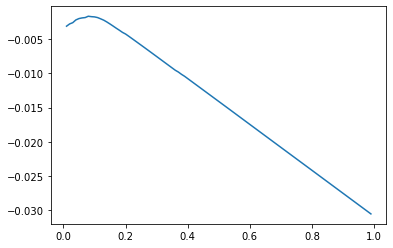

In [14]:
alpha = []
error = []
for i in range(1,100):
    alpha.append(i/100)
    l = Lasso(alpha=(i/100))
    error.append(np.mean(cross_val_score(l,X_train,y_train, scoring = 'neg_mean_absolute_error', cv= 3)))    
plt.plot(alpha,error)

In [16]:
error = tuple(zip(alpha,error))
df_error = pd.DataFrame(error, columns = ['alpha','error'])
df_error[df_error.error == max(df_error.error)]

,alpha,error
98,0.99,"(0.99, -0.0305228026263754)"


In [17]:
# random forest 
from sklearn.ensemble import RandomForestRegressor
rfr = RandomForestRegressor()
np.mean(cross_val_score(rfr, X_train,y_train,scoring = 'neg_mean_absolute_error', cv= 3))

-1.172187902017799

In [19]:
# tune models GridsearchCV 
from sklearn.model_selection import GridSearchCV
parameters = {'n_estimators':range(10,300,10), 'criterion':('mse','mae'), 'max_features':('auto','sqrt','log2')}
gr = GridSearchCV(rfr,parameters,scoring='neg_mean_absolute_error',cv=3)
gr

GridSearchCV(cv=3, estimator=RandomForestRegressor(),
             param_grid={'criterion': ('mse', 'mae'),
                         'max_features': ('auto', 'sqrt', 'log2'),
                         'n_estimators': range(10, 300, 10)},
             scoring='neg_mean_absolute_error')

In [20]:
gr.fit(X_train,y_train)

GridSearchCV(cv=3, estimator=RandomForestRegressor(),
             param_grid={'criterion': ('mse', 'mae'),
                         'max_features': ('auto', 'sqrt', 'log2'),
                         'n_estimators': range(10, 300, 10)},
             scoring='neg_mean_absolute_error')

In [21]:
gr.best_score_
gr.best_estimator_



RandomForestRegressor(n_estimators=160)

In [23]:
tpred_lm = lm.predict(X_test)
tpred_ls = ls.predict(X_test)
tpred_rfr = gr.best_estimator_.predict(X_test)



In [24]:
from sklearn.metrics import mean_absolute_error
mean_absolute_error(y_test,tpred_lm)


9.170848312160419e-05

In [25]:
mean_absolute_error(y_test,tpred_ls)


0.0022206981412735785

In [26]:
mean_absolute_error(y_test,tpred_rfr)



0.9430059523809525

In [29]:
mean_absolute_error(y_test,(tpred_lm+tpred_rfr)/2)



0.47151598593126015

In [31]:
import pickle
pickl = {'model': gr.best_estimator_}
pickle.dump( pickl, open( 'model_file' + ".p", "wb" ) )



In [34]:
file_name = "model_file.p"
with open(file_name, 'rb') as pickled:
    data = pickle.load(pickled)
    model = data['model']



In [35]:
model.predict(np.array(list(X_test.iloc[1,:])).reshape(1,-1))[0]



119.225

In [36]:
list(X_test.iloc[1,:])

[3.8,
 1996.0,
 0.0,
 0.0,
 93.0,
 149.0,
 24.0,
 1.0,
 0.0,
 1.0,
 0.0,
 1.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 1.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.